In [64]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import time
import numpy as np
import cv2

%matplotlib inline

In [65]:
import os

def loadImages(folder):
    imgs = []
    for img_name in sorted(os.listdir(folder)):
        if img_name.endswith(".png"):
            img_path = os.path.join(folder, img_name)
            
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)    # BGR -> gray
            img = img.astype(np.float64)    # uint8 -> float
            img /= 255.    # [0, 255] -> [0, 1]
            imgs.append(img)
    
    return imgs

In [56]:
imgs = loadImages("images")

sift = cv2.SIFT_create()
detected_corners = []
features = []
for img in imgs:
    kp, desc = sift.detectAndCompute(img, None)
    detected_corners.append([(k.pt[1], k.pt[0])for k in kp])
    features.append([d for d in desc])


kp1, desc1 = sift.detect(img[0])
kp2, desc2 = sift.detect(img[1])

H, status = cv.findHomography(kp1, kp2, cv.RANSAC,4.0)



error: OpenCV(4.5.4) ../modules/features2d/src/sift.dispatch.cpp:477: error: (-5:Bad argument) image is empty or has incorrect depth (!=CV_8U) in function 'detectAndCompute'


In [ ]:
imgs = loadImages("images")

stitcher = cv2.Stitcher.create(cv2.Stitcher_PANORAMA)
status, pano = stitcher.stitch(imgs)
# ratio = 0.8

# kp1, desc1 = sift.detectAndCompute(imgs[0], None)
# kp2, desc2 = sift.detectAndCompute(imgs[1], None)

# matcher = cv2.BFMatcher(cv2.NORM_HAMMING2)
# matches = matcher.knnMatch(desc1.astype(np.uint8), desc2.astype(np.uint8), 2)

# good_matches = [first for first, second in matches \
#                     if first.distance < second.distance * ratio]
# src_pts = np.float32([ kp1[m.queryIdx].pt for m in good_matches ])
# dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good_matches ])

# H, status = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 4.0)

# result = cv2.warpPerspective(imgs[0], H,
#     (imgs[0].shape[1] + imgs[0].shape[1], imgs[0].shape[0]))
# result[0:imgs[0].shape[0], 0:imgs[0].shape[1]] = (imgs[1] + result[0:imgs[0].shape[0], 0:imgs[0].shape[1]]) / 2

plt.figure(dpi=200)
plt.axis("off")
plt.imshow(cv2.cvtColor(pano, cv2.COLOR_BGR2RGB))
# res = cv2.drawMatches(imgs[0], kp1, imgs[1], kp2, good_matches, None, \
                    # flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

# plt.imshow(res, cmap="gray")
plt.show()

error: OpenCV(4.5.4) ../modules/imgproc/src/color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function 'cv::impl::(anonymous namespace)::CvtHelper<cv::impl::(anonymous namespace)::Set<3, 4, -1>, cv::impl::(anonymous namespace)::Set<1, -1, -1>, cv::impl::(anonymous namespace)::Set<0, 2, 5>, cv::impl::(anonymous namespace)::NONE>::CvtHelper(cv::InputArray, cv::OutputArray, int) [VScn = cv::impl::(anonymous namespace)::Set<3, 4, -1>, VDcn = cv::impl::(anonymous namespace)::Set<1, -1, -1>, VDepth = cv::impl::(anonymous namespace)::Set<0, 2, 5>, sizePolicy = cv::impl::(anonymous namespace)::NONE]'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 1


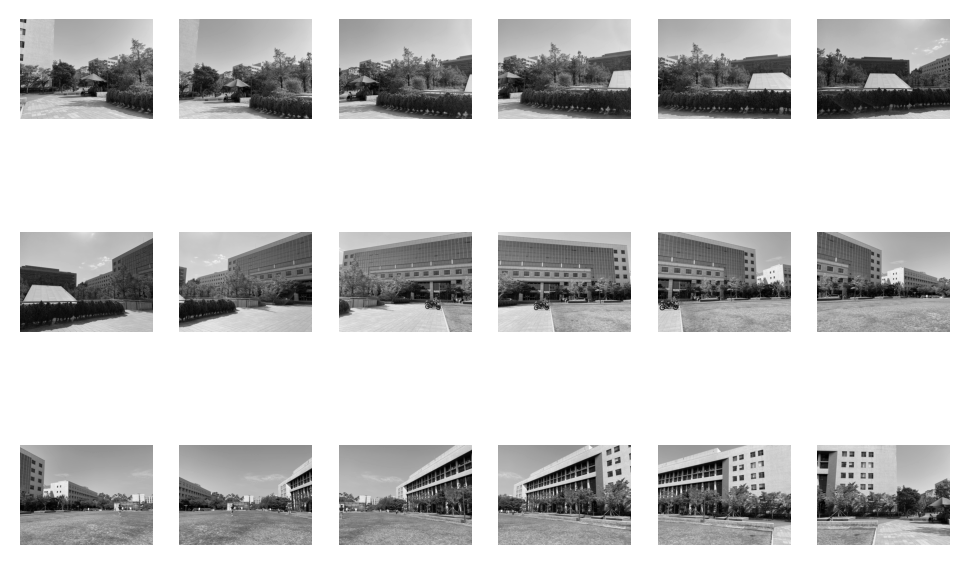

In [66]:
imgs = loadImages("images")
fig = plt.figure(dpi=200)
plt.tight_layout()
for i, img in enumerate(imgs):
    plt.subplot(3, 6, i+1)
    plt.axis("off")
    plt.imshow(img, cmap="gray")
plt.show()

In [67]:
# Define Filter function for sobel filtering
def filter(weights, roi):
    # these two lines are important as they ensure correct
    # computations!
    weights = weights.astype(float)    # convert correctly
    roi = roi.astype(float)            # convert correctly
    # this holds the end result
    filtered = np.zeros_like(roi)
    width = int((weights.shape[1]-1)/2)
    height = int((weights.shape[0]-1)/2)
    # do the filtering
    for i in range(height,roi.shape[1]-height):
        for j in range(width,roi.shape[0]-width):
            filtered[j,i] = (weights * roi[j-width:j+width+1, i-height:i+height+1]).sum()       # how do you create the output of the filtering?
    
    return filtered

# To select local maximum
def non_local_maximum_suppression(values, winSize=11):
    result = values.copy()
    for i in range(values.shape[0] - winSize):
        for j in range(values.shape[1] - winSize):
            local_patch = result[i:i+winSize,j:j+winSize]
            
            if local_patch.sum() > 0:
                local_patch[local_patch.max() != local_patch] = 0
    
    return result

def getFeaturePoints(img, winSize=15, threshold=0.01):
    # Define Sobel filter and filtering
    sobel_x = np.array([
        [-1, 0, 1],
        [-2, 0, 2],
        [-1, 0, 1],
    ])
    sobel_y = np.array([
        [1, 2, 1],
        [0, 0, 0],
        [-1, -2, -1],
    ])

    i_x = filter(sobel_x, img)
    i_y = filter(sobel_y, img)

    # Define Harris Matrix
    sum_kernel = np.ones((winSize, winSize)) / winSize ** 2

    A = filter(sum_kernel, i_x ** 2)
    B = filter(sum_kernel, i_x * i_y)
    C = filter(sum_kernel, i_y ** 2)

    harris_operator = (A * C - B ** 2) / (A + C)
    harris_operator = np.where(np.isnan(harris_operator), 0, harris_operator)
    
    # Threshold
    thresholded = np.where(harris_operator > threshold, harris_operator, 0)
    
    # Find local max value
    corners = non_local_maximum_suppression(thresholded, winSize=(winSize // 2) + 1) > 0

    return np.argwhere(corners.astype(float) == 1)

/var/folders/hy/gbr725417rvfhm8_bksjlcgc0000gn/T/ipykernel_14053/690509504.py:53: RuntimeWarning: invalid value encountered in true_divide
  harris_operator = (A * C - B ** 2) / (A + C)


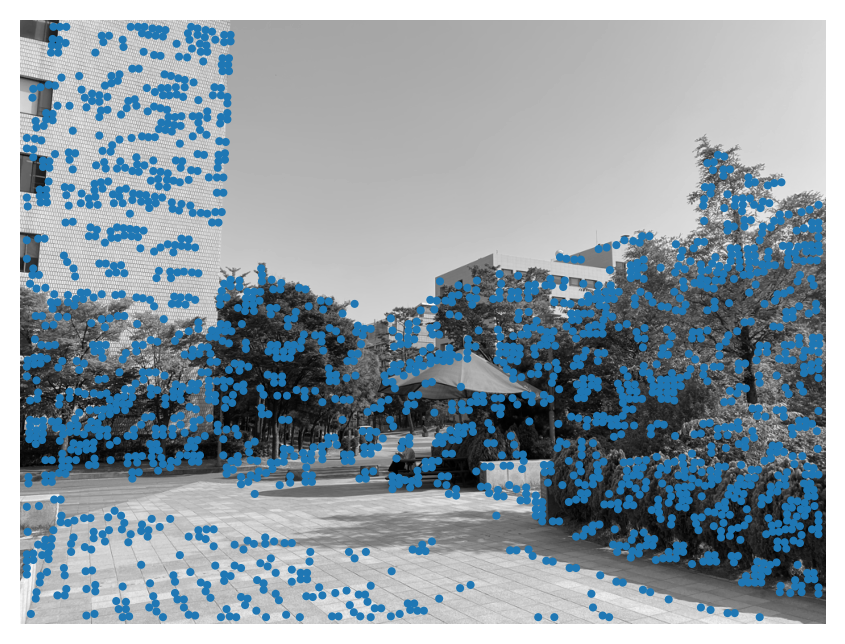

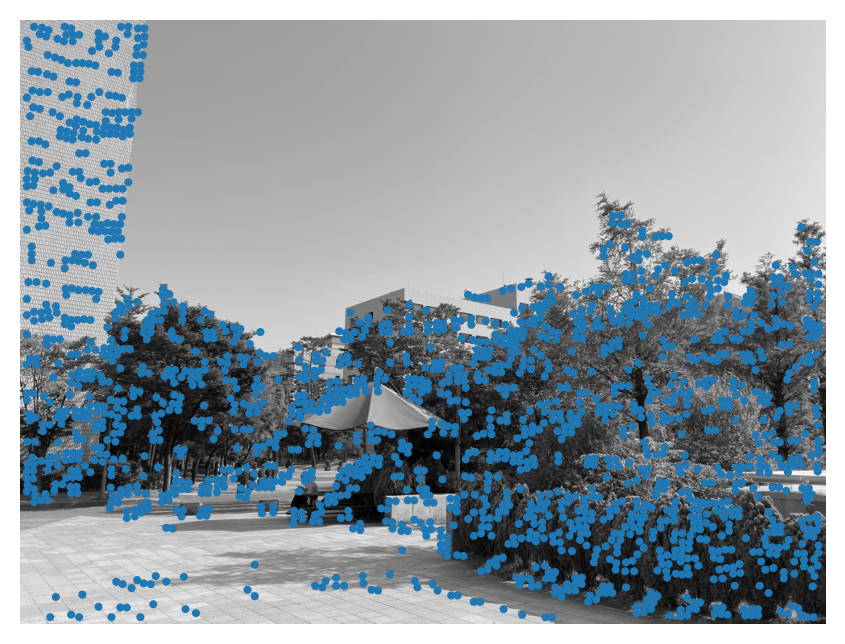

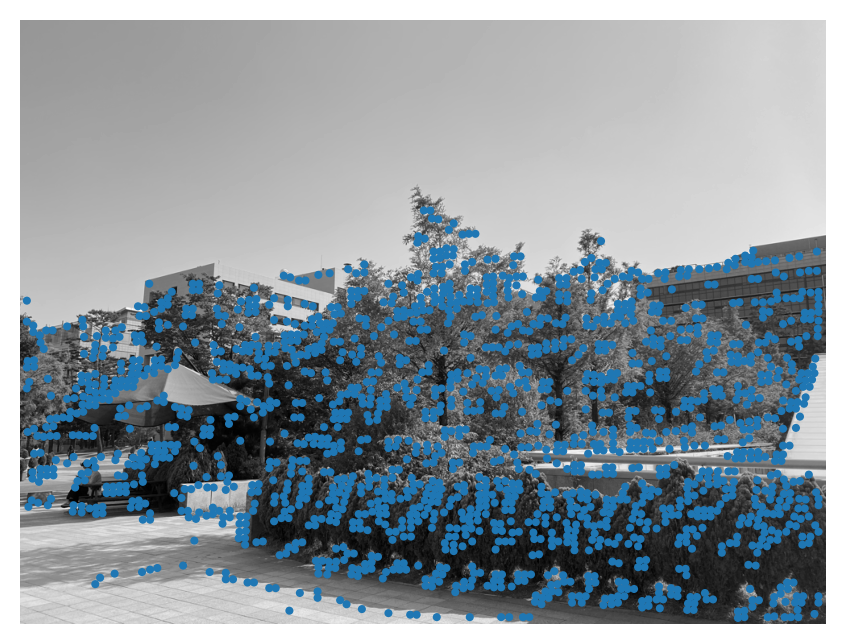

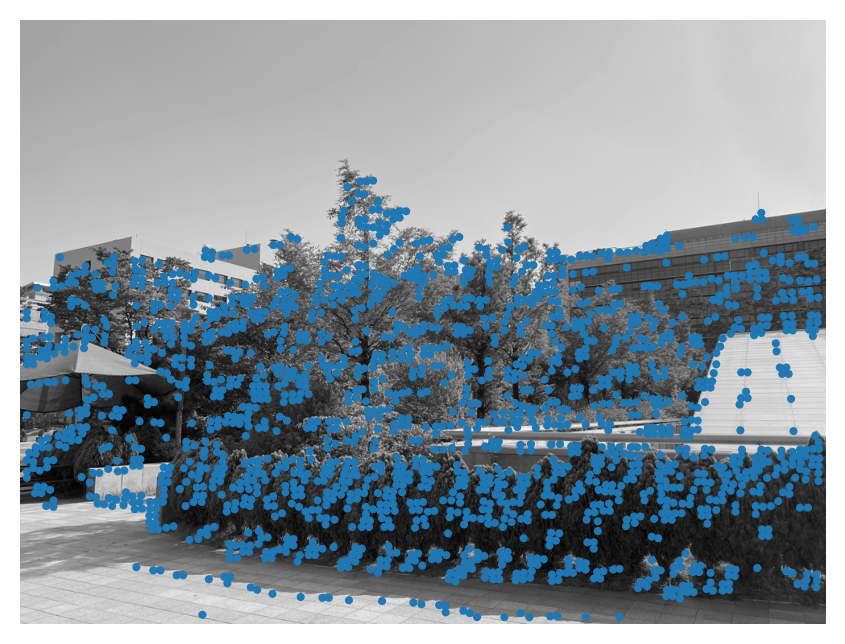

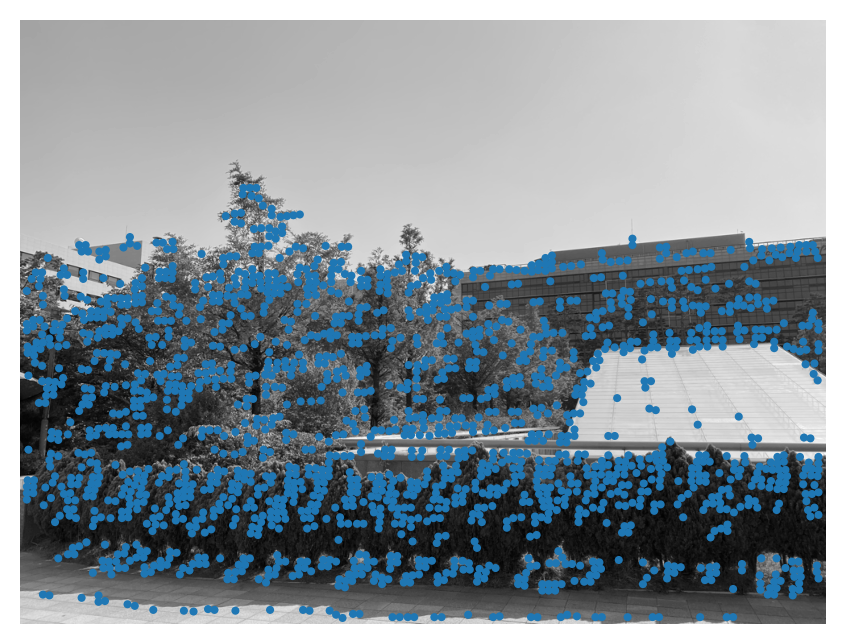

...

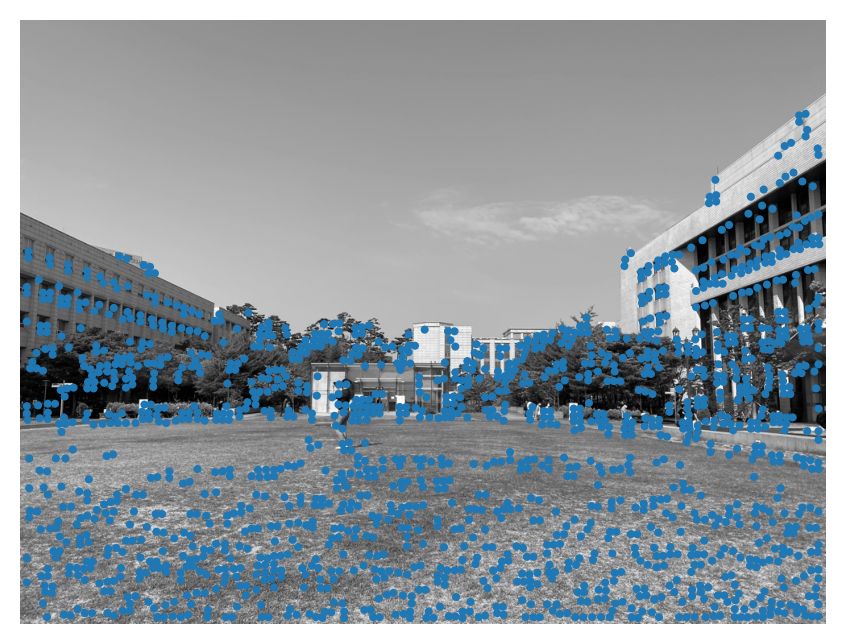

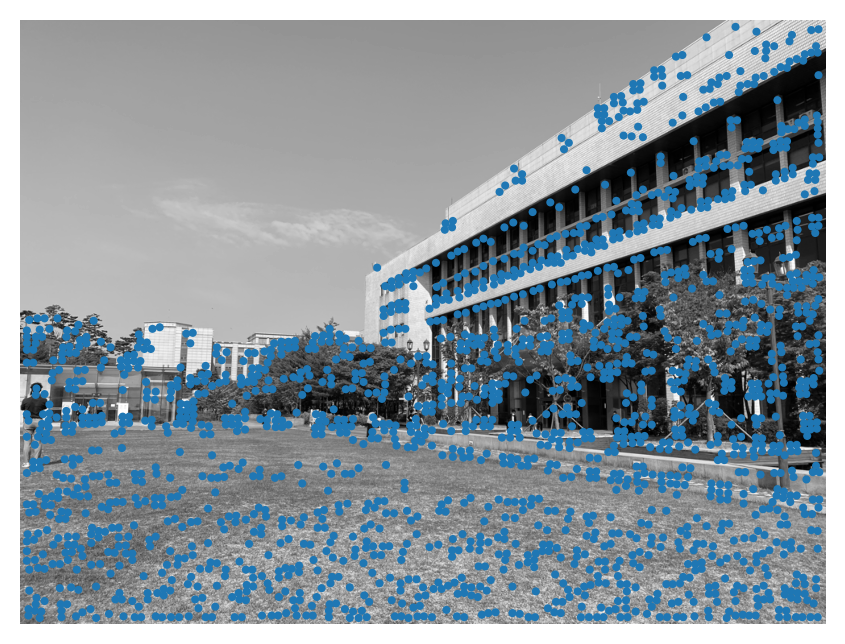

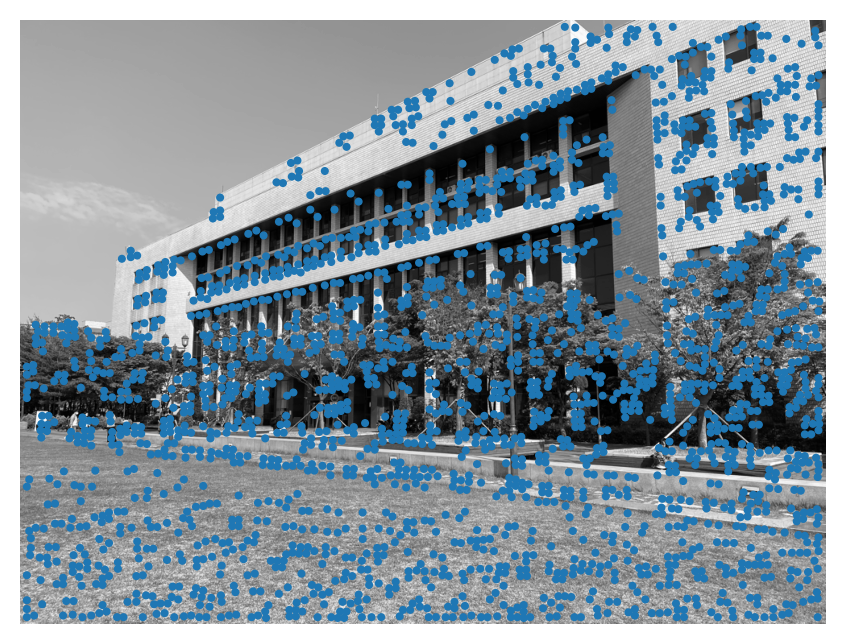

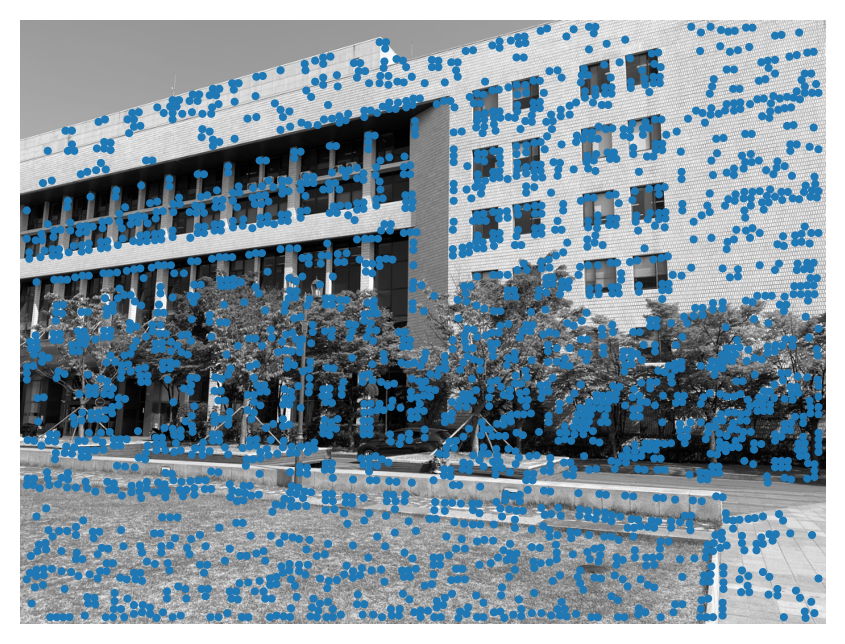

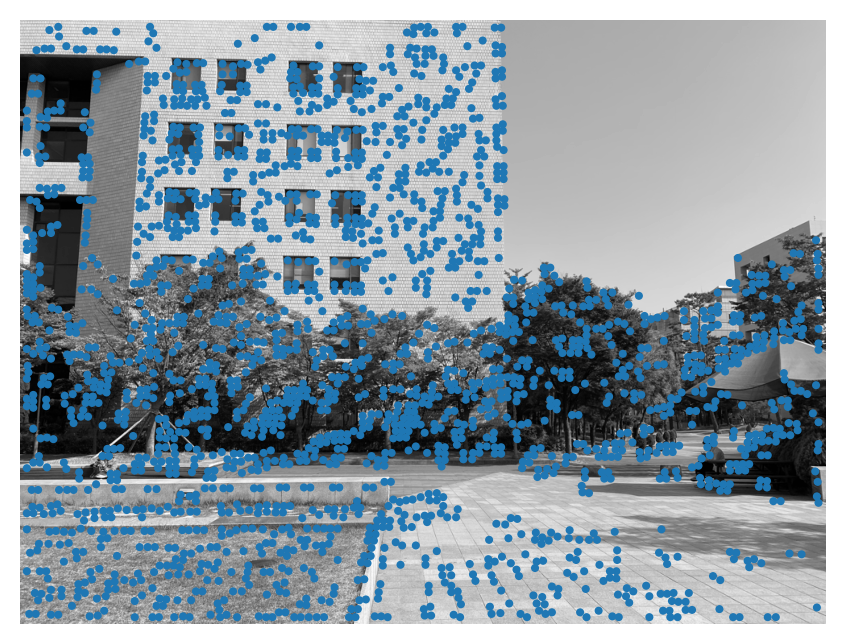

In [68]:
detected_corners = []
window_size = 15
threshold = 0.01

for i, img in enumerate(imgs):
    _, ax = plt.subplots(dpi=200)
    plt.axis("off")
    plt.imshow(img, cmap="gray")
    detected = getFeaturePoints(img, winSize=window_size, threshold=threshold)
    detected_corners.append(detected)
    
    # Draw corners
    for y, x in detected:
        ax.add_patch(mpl.patches.Circle((x, y), 5, fill=True))

    plt.show()

In [69]:
def getFeatureDescriptors(imgs, detected_corners, window_size=15):
    half_size = window_size // 2
    
    results = []
    for img, detected in zip(imgs, detected_corners):
        features = []
        img = np.pad(img, (half_size, half_size), mode="constant")    # To address out of range
        for y, x in detected:
            roi = img[y:y+window_size, x:x+window_size]    # because of the padding same as [y-half:y+half+1, x-half:x+half+1]
            
            feature = roi.reshape(-1)
            assert len(feature) == window_size ** 2, f"feature shape: {feature.shape}"
            features.append(feature)
        
        results.append(features)
    
    return results

In [70]:
features = getFeatureDescriptors(imgs, detected_corners)

print("Number of corners", [len(detected) for detected in detected_corners])
print("Number of features", [len(feature) for feature in features])
print("Feature dimension", features[0][0].shape)

Number of corners [1943, 1738, 1718, 1773, 1792, 1511, 1481, 1821, 2321, 2424, 2333, 1983, 1585, 1509, 1857, 2251, 2547, 2193]
Number of features [1943, 1738, 1718, 1773, 1792, 1511, 1481, 1821, 2321, 2424, 2333, 1983, 1585, 1509, 1857, 2251, 2547, 2193]
Feature dimension (225,)


In [71]:
def match2Images(imgs, corners, features, threshold, criterion="euclidian", plot=True):
    assert len(corners) == 2, f"Only support two images but length of corners is {len(corners)}"
    assert len(features) == 2, f"Only support two images but length of features is {len(features)}"
    assert criterion in ["euclidian", "correlation"], f"criterion supports only two types of 'euclidian', 'correlation' but given is {criterion}"
    
    # Based on small number of corners
    if len(features[0]) <= len(features[1]):
        features_A = np.stack(features[0])
        features_B = np.stack(features[1])
    else:
        features_A = np.stack(features[1])
        features_B = np.stack(features[0])

    # Get pairwise distance
    if criterion == "euclidian":
        # pairwise euclidian distance
        distance_matrix = ((features_A[:, np.newaxis, :] - features_B[np.newaxis, :, :]) ** 2).mean(axis=-1)    # [N, M]
    else:
        # pairwise normalized cross correlation
        mean_A = features_A.mean(axis=-1, keepdims=True)
        mean_B = features_B.mean(axis=-1, keepdims=True)
        shifted_A = features_A - mean_A    # X - E(X)
        shifted_B = features_B - mean_B    # X - E(X)
        std_A = features_A.std(axis=-1)
        std_B = features_B.std(axis=-1)
        
        correlation_matrix = std_A[:, np.newaxis] * std_B[np.newaxis, :]    # [N, M]
        similarity_matrix = (shifted_A[:, np.newaxis, :]  * shifted_B[np.newaxis, :, :]).mean(axis=-1) / correlation_matrix
        
        # Transform range for compatibility with Euclidian distance [-1, 1] -> [-2, 0] -> [0, 2] -> [0, 1] 
        distance_matrix = -0.5 * (similarity_matrix - 1.)
        
    sorted_indices = np.argsort(distance_matrix, axis=-1)

    dummy_indices = np.arange(sorted_indices.shape[0])    # for selecting 1st, 2nd distance indices
    matched_indices = sorted_indices[:, 0]    # shortest distance
    second_indices = sorted_indices[:, 1]
    
    first_distance = distance_matrix[dummy_indices, matched_indices]    # 1st distance
    second_distance = distance_matrix[dummy_indices, second_indices]    # 2nd distance
    ratio_distance = first_distance / second_distance    # ratio distance
    
    # non minmum suppression for duplicated matches because we only consider shortest distance independently.
    nms_mask = np.zeros(sorted_indices.shape[0], dtype=np.bool) # for selecting indices after nms
    unique_indices = np.unique(matched_indices)
    for index in unique_indices:
        mask = matched_indices == index
        
        if mask.sum() == 1:
            nms_mask = np.logical_or(nms_mask, mask)
        else:
            max_index = np.argwhere(mask == 1)[np.argmin(ratio_distance[dummy_indices[mask]])]
            nms_mask[max_index] = 1
    
    dummy_indices = dummy_indices[nms_mask]
    matched_indices = matched_indices[nms_mask]
    ratio_distance = ratio_distance[nms_mask]

    ratio_mask = ratio_distance < threshold
    thresholded_indices = np.stack([dummy_indices[ratio_mask], matched_indices[ratio_mask]], axis=-1)
    
    if len(features[0]) > len(features[1]):
        # switch A, B
        thresholded_indices = np.stack([
            thresholded_indices[:, 1],
            thresholded_indices[:, 0],
        ], axis=-1)
    
    if plot:
        height, width = imgs[0].shape[:2]
        concat_imgs = np.concatenate(imgs, axis=1)
        
        _, ax = plt.subplots(dpi=200)
        
        plt.axis("off")
        plt.imshow(concat_imgs, cmap="gray")
        
        # Draw corners
        for i, j in thresholded_indices:
            y_i, x_i = corners[0][i]
            y_j, x_j = corners[1][j]
            ax.add_patch(
                mpl.patches.Circle(
                    (x_i, y_i),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Circle(
                    (x_j + width, y_j),                   # (x, y)
                    5,
                    fill=True,
            ))
            ax.add_patch(
                mpl.patches.Arrow(
                    x_i, y_i,
                    x_j + width - x_i, y_j - y_i,
                    width=5,
                )
            )
        plt.show()
    
    return thresholded_indices

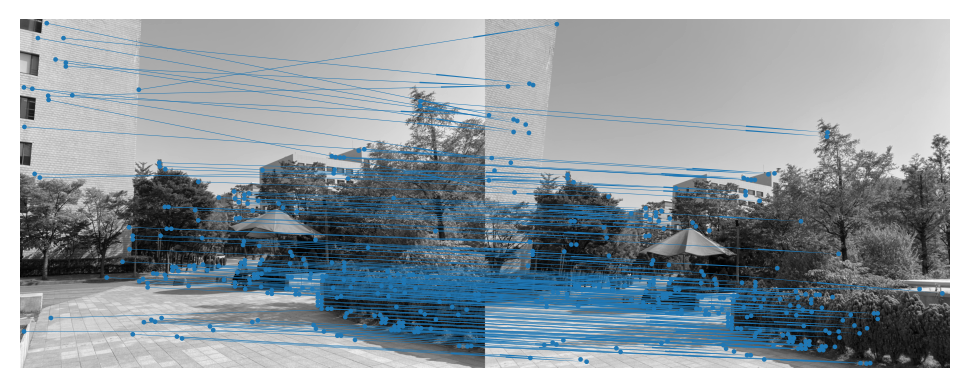

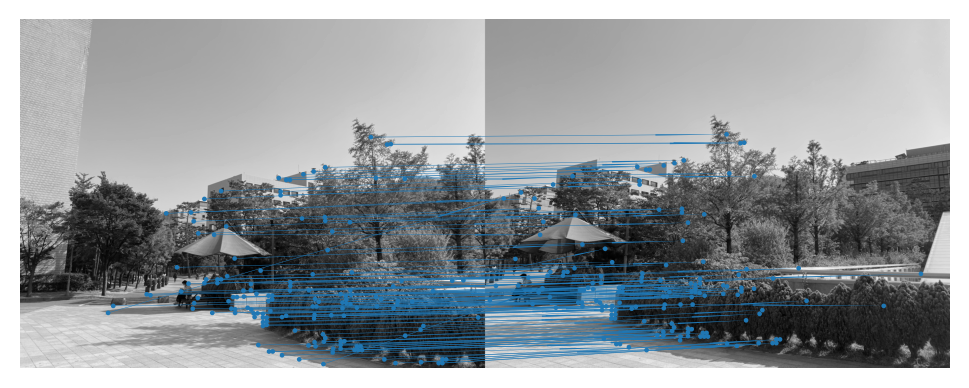

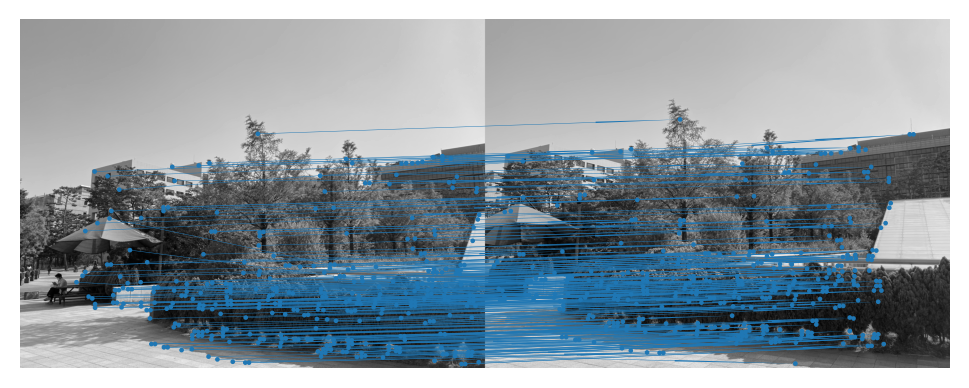

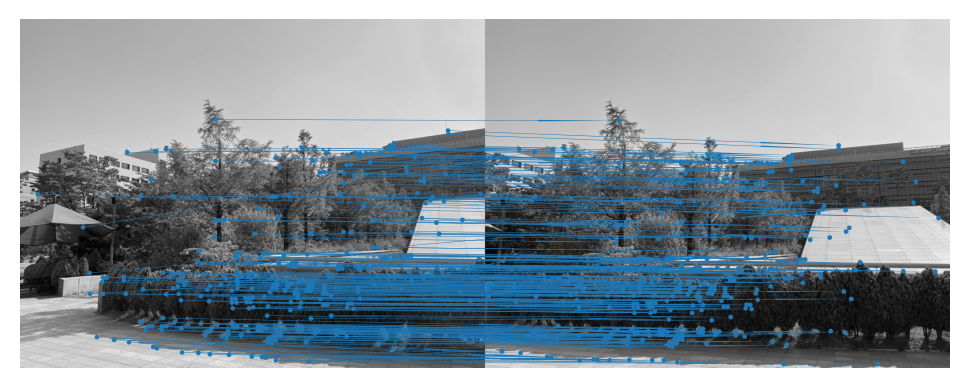

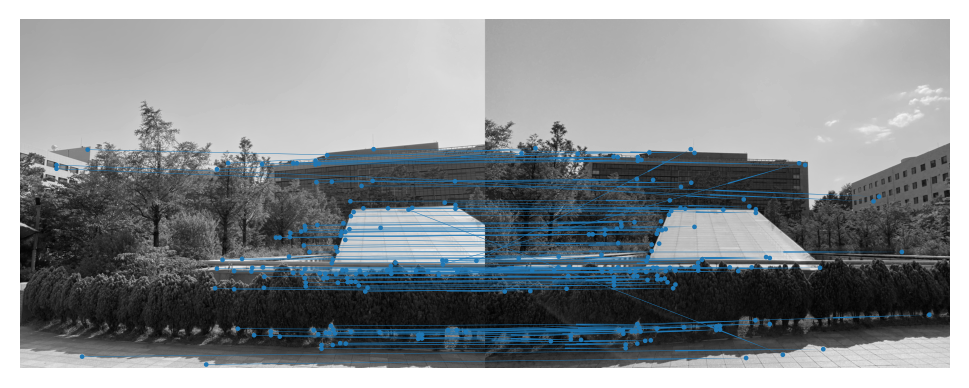

...

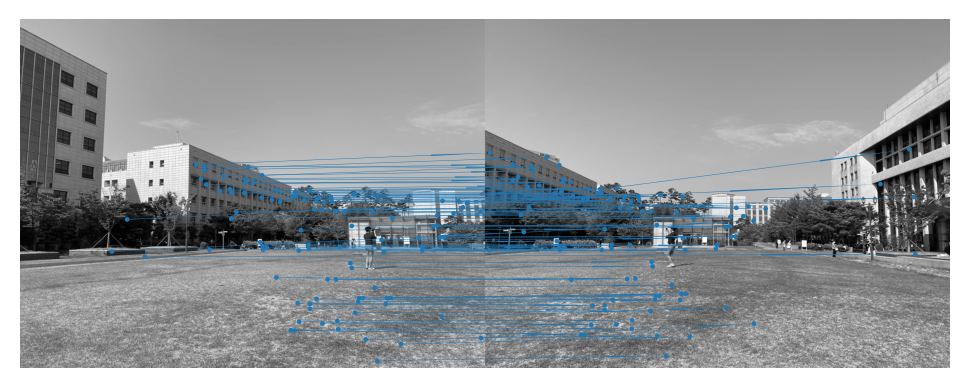

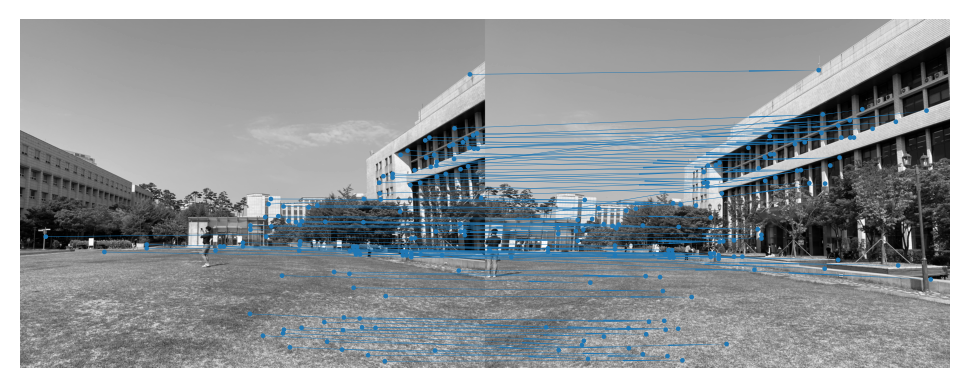

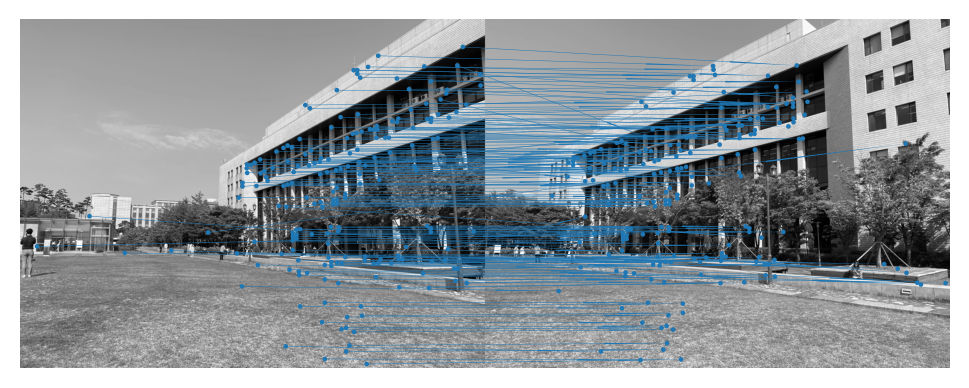

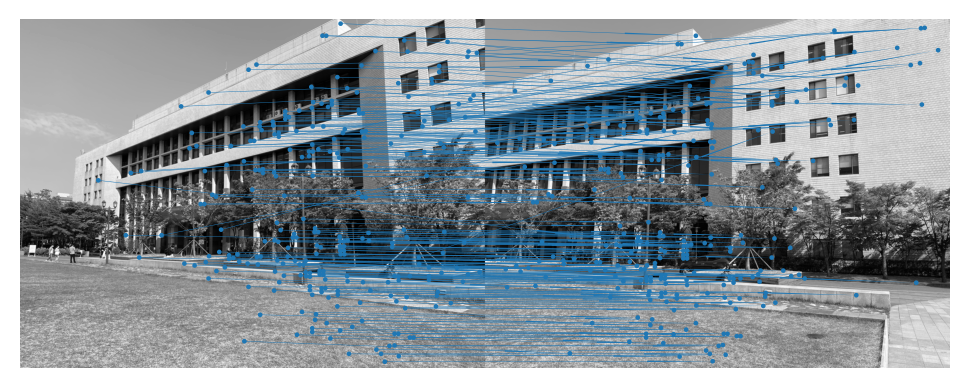

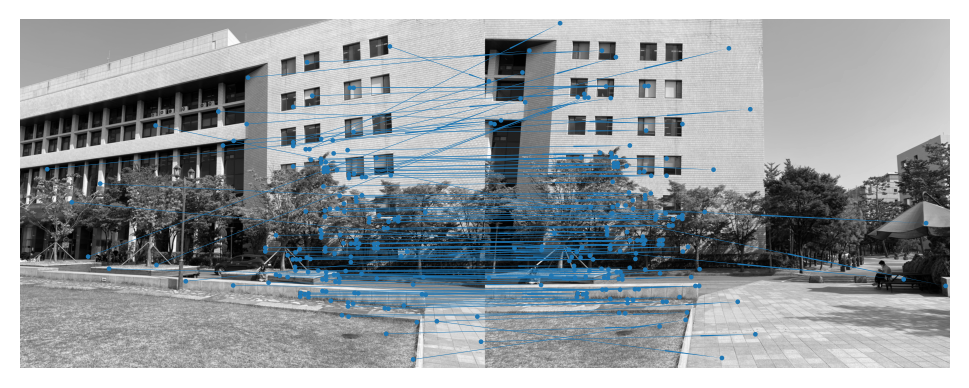

In [72]:
matched_indices = []
threshold = 0.7
for i in range(len(imgs) - 1):
    matched_indices.append(match2Images(imgs[i:i+2], detected_corners[i:i+2], features[i:i+2], threshold, criterion="correlation"))

In [244]:
def refineMatches(imgs, corners, matched_indices, threshold, num_iter=10000, num_points=4, plot=True):
    assert len(imgs) == 2, f"Only support two images but length of imgs is {len(imgs)}"
    assert len(corners) == 2, f"Only support two images but length of corners is {len(corners)}"
    inlier_indices = []
    result_homography = None
    result_distance = 0
    
    corners[0] = np.asarray(corners[0])
    corners[1] = np.asarray(corners[1])
    corners_A = corners[0][matched_indices[:, 0]]
    corners_B = corners[1][matched_indices[:, 1]]
    
    # homography coordinate
    # [y, x] -> [x, y, z]
    homo_corners_A = np.stack([
        corners_A[:, 1],
        corners_A[:, 0],
        np.ones(len(corners_A), dtype=corners[0].dtype)
    ], axis=-1)
    homo_corners_B = np.stack([
        corners_B[:, 1],
        corners_B[:, 0],
        np.ones(len(corners_B), dtype=corners[1].dtype)
    ], axis=-1)
    
    for i in range(num_iter):
        random_indices = np.random.choice(np.arange(len(matched_indices)), num_points)
        
        random_corners_A = corners[0][matched_indices[random_indices][:, 0]]
        random_corners_B = corners[1][matched_indices[random_indices][:, 1]]
        
        # Compute homographies
        matrix = []
        for (y1, x1), (y2, x2) in zip(random_corners_B, random_corners_A):
            matrix.append([x1, y1, 1, 0,  0,  0, -x2 * x1, -x2 * y1, -x2])
            matrix.append([0,  0,  0, x1, y1, 1, -y2 * x1, -y2 * y1, -y2])
        matrix = np.stack(matrix)

        u, s, v = np.linalg.svd(matrix)    # Singular Value Decomposition (SVD)

        eigenvector = v[-1]
        h = eigenvector.reshape(3, 3)
        h = h / h[2, 2]    # normalize
        
        # Get distance of all corners
        transformed_corners_B = np.dot(h, homo_corners_B.T).T
        transformed_corners_B = transformed_corners_B * transformed_corners_B[:, [-1]]    # normalize
        distances = np.sqrt((transformed_corners_B - homo_corners_A) ** 2).sum(axis=-1)
        
        inliers = matched_indices[distances < 5]
        if len(inliers) > len(inlier_indices):
            inlier_indices = inliers
            result_homography = h
            result_distance = distances[distances < 5].mean()
    
    if plot:
        height, width = imgs[0].shape[:2]
        concat_imgs = np.concatenate(imgs, axis=1)
        
        _, ax = plt.subplots(dpi=200)
        
        plt.axis("off")
        plt.imshow(concat_imgs, cmap="gray")
        
        # Draw corners
        for i, j in inlier_indices:
            y_i, x_i = corners[0][i]
            y_j, x_j = corners[1][j]
            # point of left image
            ax.add_patch(mpl.patches.Circle((x_i, y_i), 5, fill=True))
            # point of right image
            ax.add_patch(mpl.patches.Circle((x_j + width, y_j), 5, fill=True))
            ax.add_patch(
                mpl.patches.Arrow(
                    x_i, y_i,
                    x_j + width - x_i, y_j - y_i,
                    width=5,
                )
            )
        plt.show()
    
    return result_homography

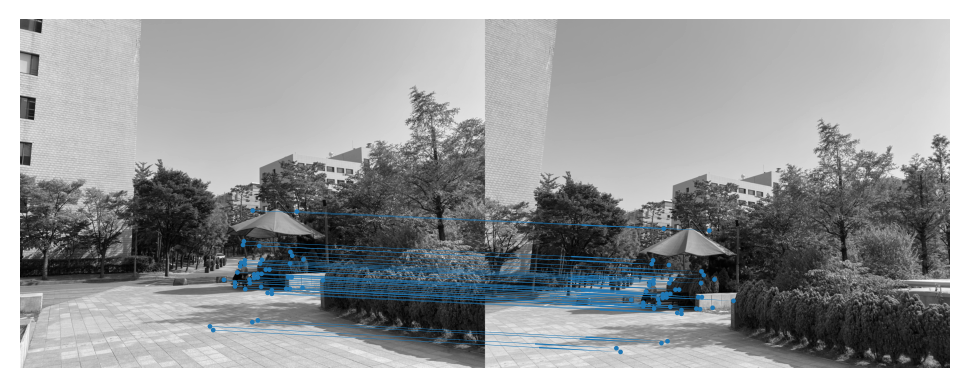

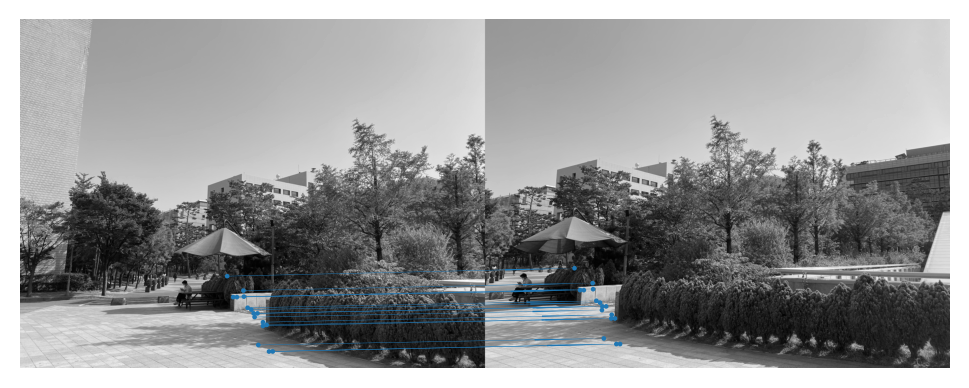

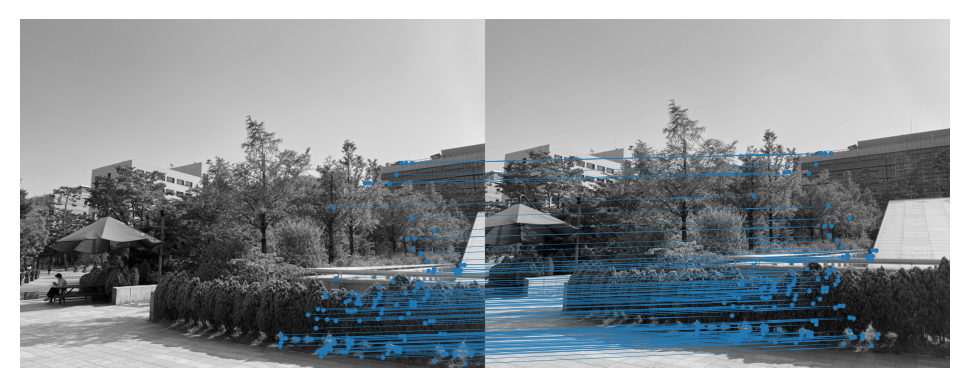

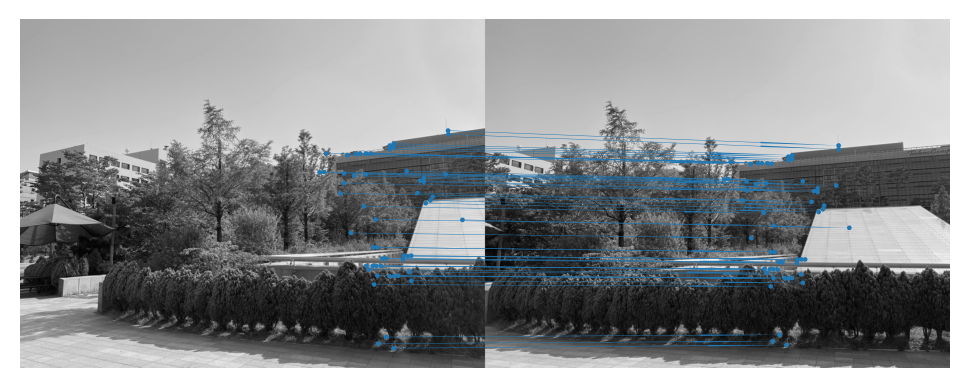

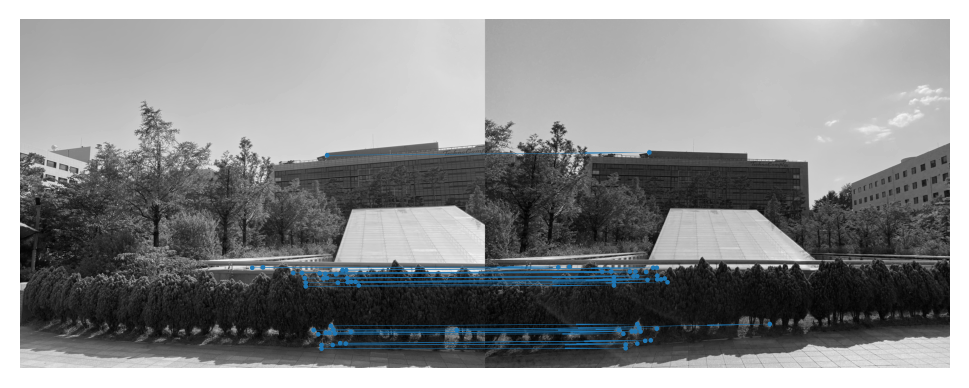

...

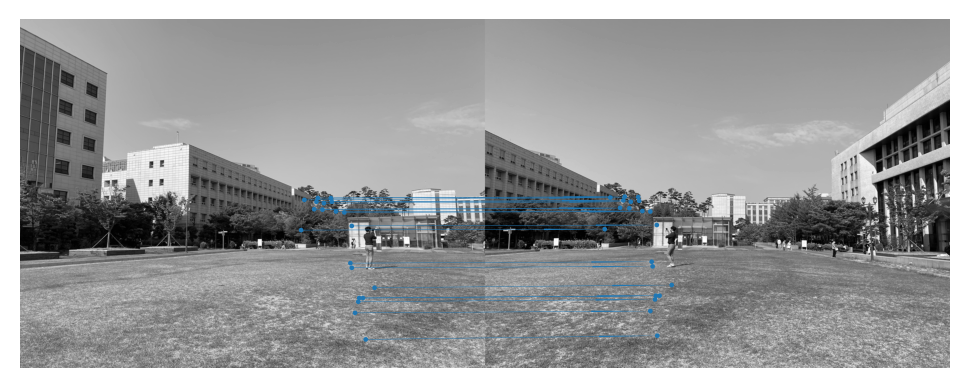

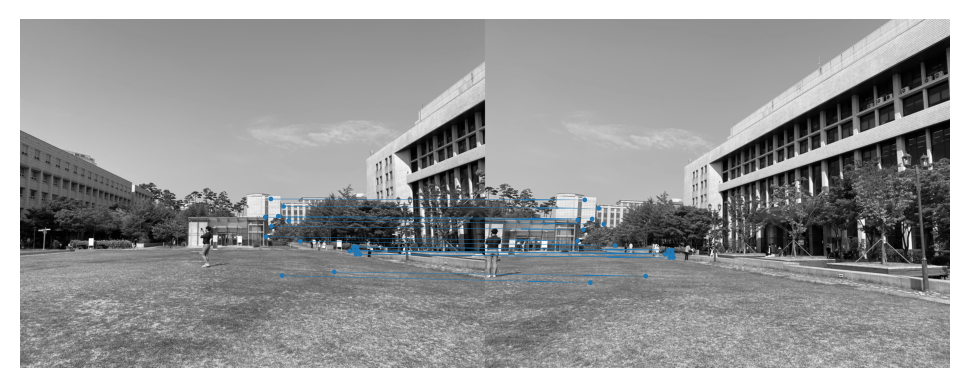

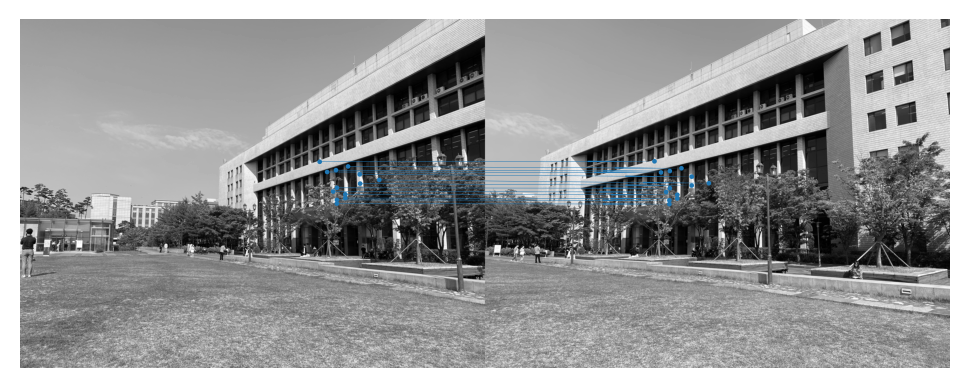

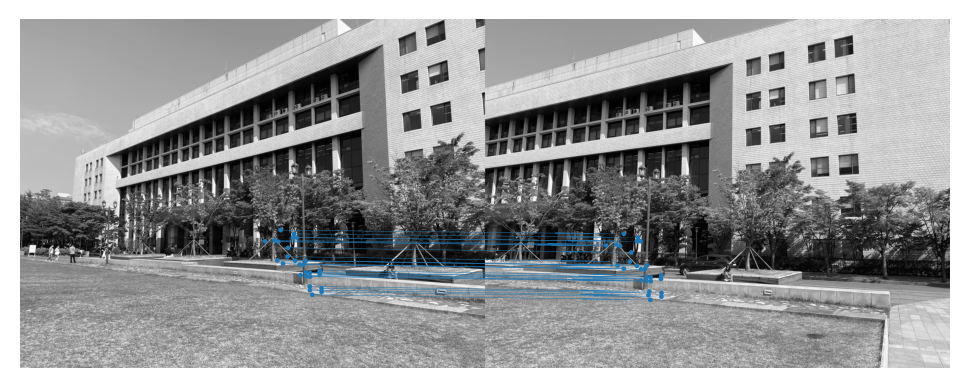

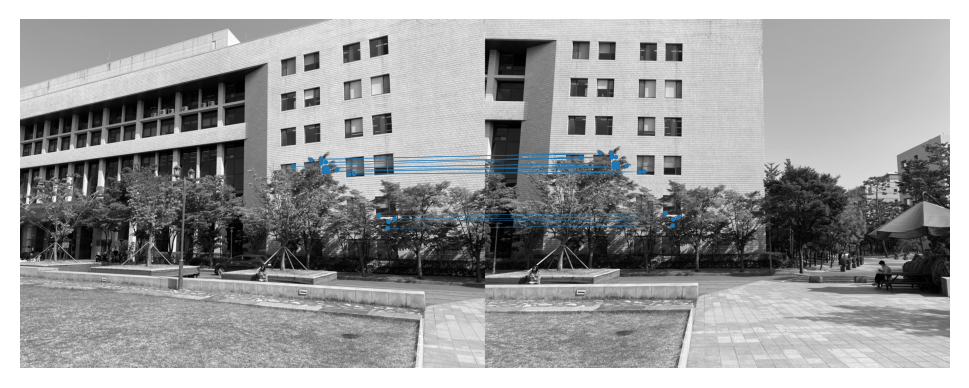

In [245]:
homographies = []
for i in range(len(imgs) - 1):
    homographies.append(refineMatches(imgs[i:i+2], detected_corners[i:i+2], matched_indices[i], 0.2))

In [268]:
def warpImages(imgs, homographies):
    # result_image = np.zeros(imgs[i].shape[0])
    img_y, img_x = imgs[0].shape[:2]
    half_x = imgs[0].shape[1] // 2
    half_y = imgs[0].shape[0] // 2
    
    # result = np.zeors(imgs[i].shape[1] * 2, imgs[i].shape[0] * 2)
    
    results = []
    
    for i in range(len(imgs) - 1):
        for j in range(i):
            result = cv2.warpPerspective(imgs[j+1], homographies[j], (imgs[i].shape[1] * 10, imgs[i].shape[0] * 2))
        homography = homographies[0]
        for j in range(i):
            homography = np.dot(homographies[j+1], homography)
        

        # shift = np.zeros_like(homography)
        # shift[0, -1] = imgs[i].shape[1] * 4
        # shift[1, -1] = imgs[i].shape[0] // 2
        # homography = homography + shift
        # print(homography, shift)
        
        results.append(result)
        # result[:750, :1000] = (imgs[i] + result[:750, :1000]) / 2
        # np.where()
        # result[half_y:half_y+img_y, half_x:half_x+img_x] =\
        #     (result[half_y:half_y+img_y, half_x:half_x+img_x] + imgs[i+1]) / 2

        # print(transfomed_img.shape, imgs[i].shape)
        # plt.imshow(transfomed_img, cmap="gray")
        # plt.imshow(np.concatenate((imgs[i], transfomed_img, imgs[i+1]), axis=1), cmap="gray")
    
    results = np.stack(results).mean(axis=0)
    plt.figure(dpi=200)
    plt.axis("off")
    plt.imshow(results, cmap="gray")
    plt.show()

[[ 9.66449217e-01  1.18538051e-02  1.25505903e+02]
 [ 1.54775924e-03  9.90020944e-01 -3.82850016e+01]
 [-4.98100497e-06  3.55491755e-07  1.00000000e+00]]
[[ 8.74520897e-01  1.15669263e-01  3.27704493e+02]
 [-3.28129556e-02  1.01836475e+00 -2.57159390e+01]
 [-1.37611988e-04  5.30513564e-05  1.00000000e+00]]
[[ 9.05066936e-01  1.75051126e-01  3.90561281e+02]
 [-3.20314253e-04  1.04745700e+00 -2.53171810e+01]
 [-1.32524110e-04  4.57678894e-05  1.00000000e+00]]
[[ 1.02248486e+00  2.30628706e-01  4.87512830e+02]
 [-3.31528532e-02  1.11626548e+00 -6.33082964e+01]
 [-1.27858458e-04  3.96818237e-05  1.00000000e+00]]
[[ 9.08088711e-01  3.22892842e-01  7.47300844e+02]
 [-1.23742118e-02  1.10577656e+00 -5.37844954e+01]
 [-1.03880665e-04  3.24220591e-05  1.00000000e+00]]
[[ 1.00234719e+00  5.56191429e-01  1.08704308e+03]
 [-6.34669185e-02  1.27859343e+00 -9.75640715e+01]
 [-2.46950412e-04  1.43838794e-04  1.00000000e+00]]
[[ 9.09628088e-01  7.32266028e-01  1.40004742e+03]
 [-1.03877973e-01  1.3297

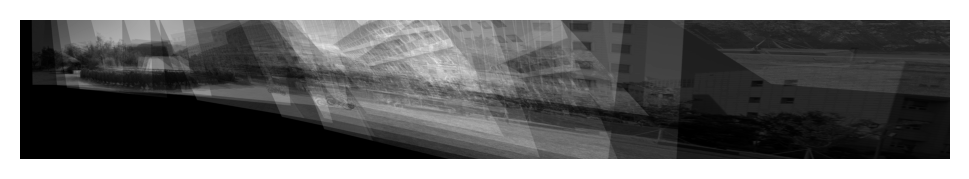

In [269]:
warpImages(imgs, homographies)

[[ 1.07076549e+00 -6.93149547e-02 -3.35177085e+02]
 [-1.91437058e-02  9.93744291e-01 -2.26072274e+00]
 [ 6.05713079e-05 -6.70535823e-05  1.00000000e+00]]


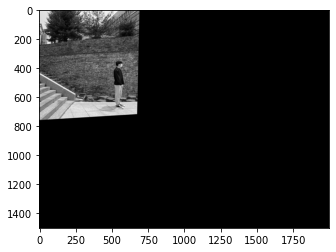

[[ 1.94317735e+00 -5.67355197e-02 -7.05097957e+02]
 [ 3.93004597e-01  1.65225882e+00 -2.97892197e+02]
 [ 9.27121975e-04  5.64158636e-05  1.00000000e+00]]
(208, 2) int64


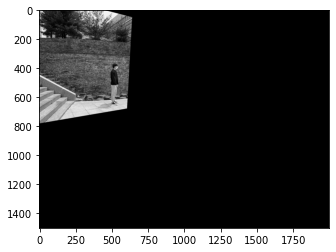

In [ ]:
print(homographies[0])

result = cv2.warpPerspective(imgs[0], homographies[0], (imgs[0].shape[1] * 2, imgs[0].shape[0] * 2))
plt.imshow(result, cmap="gray")
plt.show()
corners_A = detected_corners[0][matched_indices[0][:, 0]]
corners_B = detected_corners[1][matched_indices[0][:, 1]]
corners_A = np.stack([corners_A[:, 1], corners_A[:, 0]], axis=1)
corners_B = np.stack([corners_B[:, 1], corners_B[:, 0]], axis=1)

H, status = cv2.findHomography(corners_A, corners_B, cv2.RANSAC, 4.0)
print(H)


# transfomed_img = cv2.warpPerspective(imgs[i], homography, (imgs[i].shape[1], imgs[i].shape[0]))
# transfomed_img = cv2.warpPerspective(imgs[i], homographies[i], (imgs[i].shape[1], imgs[i].shape[0]))
print(corners_A.shape, corners_A.dtype)
result = cv2.warpPerspective(imgs[0], H, (imgs[0].shape[1] * 2, imgs[0].shape[0] * 2))
# result[0:imgs[1].shape[0], 0:imgs[1].shape[1]] = imgs[1]#(result[0:imgs[1].shape[0], 0:imgs[1].shape[1]] + imgs[1]) / 2

plt.imshow(result, cmap="gray")
plt.show()

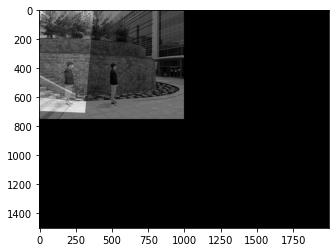

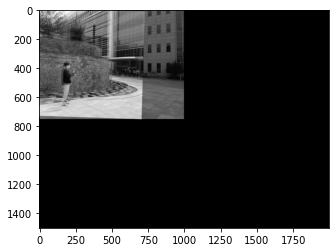

In [57]:
warpImages(imgs, homographies)

In [58]:
THRESHOLD = 0.6
NUM_ITERS = 1000

def computeHomography(pairs):
    """
    Solves for the homography given any number of pairs of points. Visit
    http://6.869.csail.mit.edu/fa12/lectures/lecture13ransac/lecture13ransac.pdf
    slide 9 for more details.
    """
    A = []
    for x1, y1, x2, y2 in pairs:
        A.append([x1, y1, 1, 0, 0, 0, -x2 * x1, -x2 * y1, -x1])
        A.append([0, 0, 0, x1, y1, 1, -y2 * x1, -y2 * y1, -y1])
    A = np.array(A)

    # Singular Value Decomposition (SVD)
    U, S, V = np.linalg.svd(A)

    # V has shape (9, 9) for any number of input pairs. V[-1] is the eigenvector
    # of (A^T)A with the smalles eigenvalue. Reshape into 3x3 matrix.
    H = np.reshape(V[-1], (3, 3))

    # Normalization
    H = (1 / H.item(8)) * H
    return H

def dist(pair, H):
    """ Returns the geometric distance between a pair of points given the
    homography H. """
    # points in homogeneous coordinates
    p1 = np.array([pair[0], pair[1], 1])
    p2 = np.array([pair[2], pair[3], 1])

    p2_estimate = np.dot(H, np.transpose(p1))
    p2_estimate = (1 / p2_estimate[2]) * p2_estimate
    
    return np.linalg.norm(np.transpose(p2) - p2_estimate)

def RANSAC(point_map, threshold=THRESHOLD, verbose=True):
    if verbose: print(f'Running RANSAC with {len(point_map)} points...')
    bestInliers = set()
    homography = None
    for i in range(NUM_ITERS):
        # randomly choose 4 points from the matrix to compute the homography
        pairs = [point_map[i] for i in np.random.choice(len(point_map), 4)]

        H = computeHomography(pairs)
        inliers = {(c[0], c[1], c[2], c[3]) for c in point_map if dist(c, H) < 500}
        
        if verbose:
            print(f'\x1b[2K\r└──> iteration {i + 1}/{NUM_ITERS} ' + \
                  f'\t{len(inliers)} inlier' + ('s ' if len(inliers) != 1 else ' ') + \
                  f'\tbest: {len(bestInliers)}', end='')

        if len(inliers) > len(bestInliers):
            bestInliers = inliers
            homography = H
            if len(bestInliers) > (len(point_map) * threshold): break

    if verbose:
        print(f'\nNum matches: {len(point_map)}')
        print(f'Num inliers: {len(bestInliers)}')
        print(f'Min inliers: {len(point_map) * threshold}')

    return homography, bestInliers


A = detected_corners[0][matched_indices[0][:, 0]]
B = detected_corners[1][matched_indices[0][:, 1]]

A = np.stack([A[:, 1], A[:, 0]], axis=1)
B = np.stack([B[:, 1], B[:, 0]], axis=1)

matches___ = np.concatenate((A, B), axis=1)

homo, _ = RANSAC(matches___)
print(homo)
H, _ = cv2.findHomography(A, B, cv2.RANSAC, 4.0)
print(H)

IndexError: list index out of range

In [ ]:
import random
#
# Computers a homography from 4-correspondences
#
def calculateHomography(correspondences):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in correspondences:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h


#
#Calculate the geometric distance between estimated points and original points
#
def geometricDistance(correspondence, h):
    p1 = np.transpose(np.matrix([correspondence.item(0), correspondence.item(1), 1]))
    estimatep2 = np.dot(h, p1)
    estimatep2 = (1/estimatep2.item(2))*estimatep2

    p2 = np.transpose(np.matrix([correspondence.item(2), correspondence.item(3), 1]))
    error = p2 - estimatep2
    return np.linalg.norm(error)


#
#Runs through ransac algorithm, creating homographies from random correspondences
#
def ransac(corr, thresh):
    maxInliers = []
    finalH = None
    for i in range(1000):
        #find 4 random points to calculate a homography
        corr1 = corr[random.randrange(0, len(corr))]
        corr2 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((corr1, corr2))
        corr3 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr3))
        corr4 = corr[random.randrange(0, len(corr))]
        randomFour = np.vstack((randomFour, corr4))

        #call the homography function on those points
        h = calculateHomography(randomFour)
        inliers = []

        for i in range(len(corr)):
            d = geometricDistance(corr[i], h)
            if d < 5:
                inliers.append(corr[i])

        if len(inliers) > len(maxInliers):
            maxInliers = inliers
            finalH = h

        if len(maxInliers) > (len(corr)*thresh):
            break
    return finalH, maxInliers


A = detected_corners[0][matched_indices[0][:, 0]]
B = detected_corners[1][matched_indices[0][:, 1]]

A = np.stack([A[:, 1], A[:, 0]], axis=1)
B = np.stack([B[:, 1], B[:, 0]], axis=1)

matches___ = np.concatenate((A, B), axis=1)
homo, _ = ransac(matches___, 0.8)
print(homo)
H, _ = cv2.findHomography(A, B, cv2.RANSAC, 4.0)
print(H)

[[-1.82973367e-01 -6.40768287e-02  1.57090837e+02]
 [-6.08236315e-01 -3.10703195e-01  5.95767273e+02]
 [-1.04544341e-03 -4.94539698e-04  1.00000000e+00]] [[-1.82973367e-01 -6.40768287e-02  1.57090837e+02]
 [-6.08236315e-01 -3.10703195e-01  5.95767273e+02]
 [-1.04544341e-03 -4.94539698e-04  1.00000000e+00]]
[[ 8.92593714e+00  2.94284762e-01 -3.78876014e+03]
 [ 3.85454012e+00  7.11297815e+00 -2.85093446e+03]
 [ 7.53280027e-03  1.44444650e-03  1.00000000e+00]] [[ 8.92593714e+00  2.94284762e-01 -3.78876014e+03]
 [ 3.85454012e+00  7.11297815e+00 -2.85093446e+03]
 [ 7.53280027e-03  1.44444650e-03  1.00000000e+00]]
[[ 1.67882888e+00 -6.68792343e-03 -6.09477907e+02]
 [ 2.07578062e-01  1.54733967e+00 -2.01072511e+02]
 [ 5.77140766e-04  1.94704148e-04  1.00000000e+00]] [[ 1.67882888e+00 -6.68792342e-03 -6.09477907e+02]
 [ 2.07578062e-01  1.54733967e+00 -2.01072511e+02]
 [ 5.77140766e-04  1.94704148e-04  1.00000000e+00]]
[[ 1.15452697e+00 -4.86958688e-02 -4.64031434e+02]
 [-2.65730632e-01  1.3591